## Setup

In [1]:
# Data manipulation
import numpy as np
import pandas as pd

# Data visualization
from plotly import express
from plotly.graph_objects import Figure

### Pandas Options

In [2]:
# Suppress the "SettingWithCopy" warnings.
pd.options.mode.chained_assignment = None

### Plotly Theming

In [3]:
def _hide_widgets(self):
    """
    Display the chart without Plotly widgets.
    """
    self.show(config={"displayModeBar": False})

In [4]:
def _prettify(self):
    """
    Polish up aesthetic details of the chart.
    """
    self.update_layout(font={"family": "sans", 
                             "size": 14}, 
                       hoverlabel={"bordercolor": "white", 
                                   "font": {"color": "white", 
                                            "family": "sans", 
                                            "size": 12}}, 
                       title={"font": {"size": 20}},
                       template="plotly_white", 
                       width=600,
                       height=400)
    self.update_traces(opacity=0.75)
    self.update_xaxes(ticks="outside", 
                      tickcolor="white", 
                      ticklen=10)
    self.update_yaxes(ticks="outside", 
                      tickcolor="white", 
                      ticklen=10)
    return self

In [5]:
def _print(self):
    """
    Print the figure object as a dictionary.
    """
    print(self)

In [6]:
#  Monkey patch the graph_objects `Figure` class to add custom methods.
Figure.hide_widgets = _hide_widgets
Figure.prettify = _prettify
Figure.print = _print

## Data

In [7]:
test = pd.read_csv("../data/test.csv")
train = pd.read_csv("../data/train.csv")
spray = pd.read_csv("../data/spray.csv")
weather = pd.read_csv("../data/weather.csv")

In [8]:
print("   Test :", test.shape)
print("  Train :", train.shape)
print("  Spray :", spray.shape)
print("Weather :", weather.shape)

   Test : (116293, 11)
  Train : (10506, 12)
  Spray : (14835, 4)
Weather : (2944, 22)


### Test Traps

In [9]:
test.head()

,Id,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy
0,1,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
1,2,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
2,3,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
3,4,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX SALINARIUS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9
4,5,2008-06-11,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX TERRITANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.95469,-87.800991,9


In [10]:
# Set the `Date` column as the index.
test.set_index(pd.DatetimeIndex(test["Date"]), inplace=True)

# Drop unneccessary columns.
test.drop(columns=["Date", "Address", "Block", "Street", "AddressNumberAndStreet", "AddressAccuracy"], inplace=True)

In [11]:
test.head()

,Id,Species,Trap,Latitude,Longitude
Date,,,,,
2008-06-11,1,CULEX PIPIENS/RESTUANS,T002,41.95469,-87.800991
2008-06-11,2,CULEX RESTUANS,T002,41.95469,-87.800991
2008-06-11,3,CULEX PIPIENS,T002,41.95469,-87.800991
2008-06-11,4,CULEX SALINARIUS,T002,41.95469,-87.800991
2008-06-11,5,CULEX TERRITANS,T002,41.95469,-87.800991


In [12]:
test.dtypes

Id             int64
Species       object
Trap          object
Latitude     float64
Longitude    float64
dtype: object

In [13]:
test.isna().sum()

Id           0
Species      0
Trap         0
Latitude     0
Longitude    0
dtype: int64

In [14]:
test.drop_duplicates(inplace=True)

In [15]:
test.shape

(116293, 5)

### Train Traps

In [16]:
train.head()

,Date,Address,Species,Block,Street,Trap,AddressNumberAndStreet,Latitude,Longitude,AddressAccuracy,NumMosquitos,WnvPresent
0,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX PIPIENS/RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0
1,2007-05-29,"4100 North Oak Park Avenue, Chicago, IL 60634,...",CULEX RESTUANS,41,N OAK PARK AVE,T002,"4100 N OAK PARK AVE, Chicago, IL",41.954690,-87.800991,9,1,0
2,2007-05-29,"6200 North Mandell Avenue, Chicago, IL 60646, USA",CULEX RESTUANS,62,N MANDELL AVE,T007,"6200 N MANDELL AVE, Chicago, IL",41.994991,-87.769279,9,1,0
3,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX PIPIENS/RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,1,0
4,2007-05-29,"7900 West Foster Avenue, Chicago, IL 60656, USA",CULEX RESTUANS,79,W FOSTER AVE,T015,"7900 W FOSTER AVE, Chicago, IL",41.974089,-87.824812,8,4,0


In [17]:
# Set the `Date` column as the index.
train.set_index(pd.DatetimeIndex(train["Date"]), inplace=True)

# Drop unneccessary columns.
train.drop(columns=["Date", "Address", "Block", "Street", "AddressNumberAndStreet", "AddressAccuracy"], inplace=True)

In [18]:
train.head()

,Species,Trap,Latitude,Longitude,NumMosquitos,WnvPresent
Date,,,,,,
2007-05-29,CULEX PIPIENS/RESTUANS,T002,41.954690,-87.800991,1,0
2007-05-29,CULEX RESTUANS,T002,41.954690,-87.800991,1,0
2007-05-29,CULEX RESTUANS,T007,41.994991,-87.769279,1,0
2007-05-29,CULEX PIPIENS/RESTUANS,T015,41.974089,-87.824812,1,0
2007-05-29,CULEX RESTUANS,T015,41.974089,-87.824812,4,0


In [19]:
train.dtypes

Species          object
Trap             object
Latitude        float64
Longitude       float64
NumMosquitos      int64
WnvPresent        int64
dtype: object

In [20]:
train.isna().sum()

Species         0
Trap            0
Latitude        0
Longitude       0
NumMosquitos    0
WnvPresent      0
dtype: int64

In [21]:
train.drop_duplicates(inplace=True)

In [22]:
train.shape

(4669, 6)

### Spray Areas

In [23]:
spray.head()

,Date,Time,Latitude,Longitude
0,2011-08-29,6:56:58 PM,42.391623,-88.089163
1,2011-08-29,6:57:08 PM,42.391348,-88.089163
2,2011-08-29,6:57:18 PM,42.391022,-88.089157
3,2011-08-29,6:57:28 PM,42.390637,-88.089158
4,2011-08-29,6:57:38 PM,42.390410,-88.088858


In [24]:
# Drop the `Time` column.
spray.drop(columns="Time", inplace=True)

I did not set the `Date` column as the index because I need it for map plotting.

In [25]:
spray.head()

,Date,Latitude,Longitude
0,2011-08-29,42.391623,-88.089163
1,2011-08-29,42.391348,-88.089163
2,2011-08-29,42.391022,-88.089157
3,2011-08-29,42.390637,-88.089158
4,2011-08-29,42.390410,-88.088858


In [26]:
spray.dtypes

Date          object
Latitude     float64
Longitude    float64
dtype: object

In [27]:
spray.isna().sum()

Date         0
Latitude     0
Longitude    0
dtype: int64

In [28]:
spray.drop_duplicates(inplace=True)

In [29]:
spray.shape

(14294, 3)

### Weather

In [30]:
weather.head()

,Station,Date,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,...,CodeSum,Depth,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed
0,1,2007-05-01,83,50,67,14,51,56,0,2,...,,0,M,0.0,0.00,29.10,29.82,1.7,27,9.2
1,2,2007-05-01,84,52,68,M,51,57,0,3,...,,M,M,M,0.00,29.18,29.82,2.7,25,9.6
2,1,2007-05-02,59,42,51,-3,42,47,14,0,...,BR,0,M,0.0,0.00,29.38,30.09,13.0,4,13.4
3,2,2007-05-02,60,43,52,M,42,47,13,0,...,BR HZ,M,M,M,0.00,29.44,30.08,13.3,2,13.4
4,1,2007-05-03,66,46,56,2,40,48,9,0,...,,0,M,0.0,0.00,29.39,30.12,11.7,7,11.9


In [31]:
# Set the `Date` column as the index.
weather.set_index(pd.DatetimeIndex(weather["Date"]), inplace=True)

# Drop unneccessary columns.
weather.drop(columns="Date", inplace=True)

Add the geolocations of the two weather stations.
- Station 1: CHICAGO O'HARE INTERNATIONAL AIRPORT Lat: 41.995 Lon: -87.933 Elev: 662 ft. above sea level
- Station 2: CHICAGO MIDWAY INTL ARPT Lat: 41.786 Lon: -87.752 Elev: 612 ft. above sea level

In [32]:
weather["Latitude"] = weather["Station"].map({1: 41.995, 2: 41.786})
weather["Longitude"] = weather["Station"].map({1: -87.933, 2: -87.752})

In [33]:
weather.head()

,Station,Tmax,Tmin,Tavg,Depart,DewPoint,WetBulb,Heat,Cool,Sunrise,...,Water1,SnowFall,PrecipTotal,StnPressure,SeaLevel,ResultSpeed,ResultDir,AvgSpeed,Latitude,Longitude
Date,,,,,,,,,,,,,,,,,,,,,
2007-05-01,1,83,50,67,14,51,56,0,2,0448,...,M,0.0,0.00,29.10,29.82,1.7,27,9.2,41.995,-87.933
2007-05-01,2,84,52,68,M,51,57,0,3,-,...,M,M,0.00,29.18,29.82,2.7,25,9.6,41.786,-87.752
2007-05-02,1,59,42,51,-3,42,47,14,0,0447,...,M,0.0,0.00,29.38,30.09,13.0,4,13.4,41.995,-87.933
2007-05-02,2,60,43,52,M,42,47,13,0,-,...,M,M,0.00,29.44,30.08,13.3,2,13.4,41.786,-87.752
2007-05-03,1,66,46,56,2,40,48,9,0,0446,...,M,0.0,0.00,29.39,30.12,11.7,7,11.9,41.995,-87.933


#### FYI:

You can click on legends to show/hide specified traces on the chart.

In [34]:
# Hovertemplate preset
preset = ["Latitude=%{lat}", 
          "Longitude=%{lon}", 
          "<extra></extra>"]

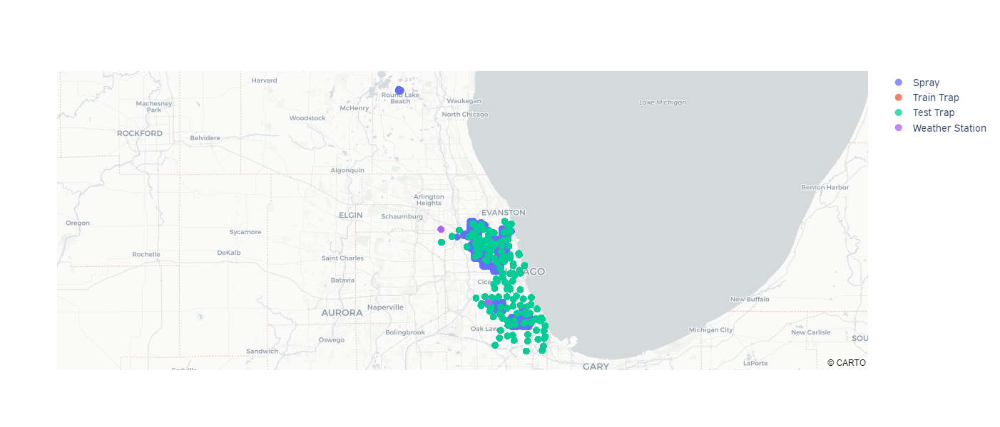

In [35]:
(Figure()
 .add_scattermapbox(name="Spray", 
                    lat=spray["Latitude"], 
                    lon=spray["Longitude"])
 .add_scattermapbox(name="Train Trap", 
                    lat=train["Latitude"], 
                    lon=train["Longitude"])
 .add_scattermapbox(name="Test Trap", 
                    lat=test["Latitude"], 
                    lon=test["Longitude"])
 .add_scattermapbox(name="Weather Station", 
                    lat=weather["Latitude"], 
                    lon=weather["Longitude"],
                    customdata=weather["Station"])
 .prettify()
 .update_layout(mapbox={"center": {"lat": 42.02, 
                                   "lon": -87.85}, 
                        "style": "carto-positron", 
                        "zoom": 8},
                width=800, 
                height=600)
 .update_traces(hovertemplate="<br>".join(preset))
 .update_traces(hovertemplate="<br>".join(["Station=%{customdata}", *preset]), 
                selector={"name": "Weather Station"})
 .update_traces(marker={"size": 10})
 .hide_widgets())

Drop outlier spray locations.

In [36]:
spray[spray["Longitude"] <= -88]

,Date,Latitude,Longitude
0,2011-08-29,42.391623,-88.089163
1,2011-08-29,42.391348,-88.089163
2,2011-08-29,42.391022,-88.089157
3,2011-08-29,42.390637,-88.089158
4,2011-08-29,42.390410,-88.088858
...,...,...,...
90,2011-08-29,42.392902,-88.093853
91,2011-08-29,42.392587,-88.093867
92,2011-08-29,42.392308,-88.093873
93,2011-08-29,42.392183,-88.093767


In [37]:
spray = spray[spray["Longitude"] > -88]

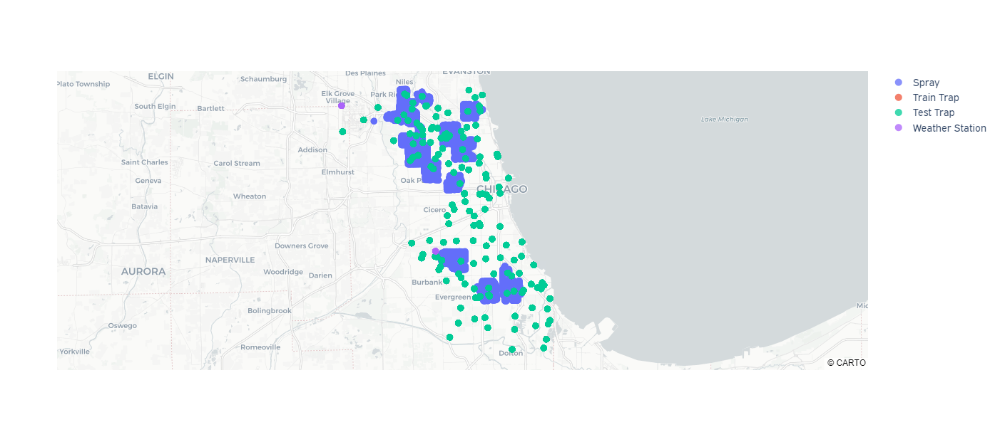

In [38]:
(Figure()
 .add_scattermapbox(name="Spray", 
                    lat=spray["Latitude"], 
                    lon=spray["Longitude"])
 .add_scattermapbox(name="Train Trap", 
                    lat=train["Latitude"], 
                    lon=train["Longitude"])
 .add_scattermapbox(name="Test Trap", 
                    lat=test["Latitude"], 
                    lon=test["Longitude"])
 .add_scattermapbox(name="Weather Station", 
                    lat=weather["Latitude"], 
                    lon=weather["Longitude"],
                    customdata=weather["Station"])
 .prettify()
 .update_layout(mapbox={"center": {"lat": 41.83, 
                                   "lon": -87.70}, 
                        "style": "carto-positron", 
                        "zoom": 9},
                width=800, 
                height=600)
 .update_traces(hovertemplate="<br>".join(preset))
 .update_traces(hovertemplate="<br>".join(["Station=%{customdata}", *preset]), 
                selector={"name": "Weather Station"})
 .update_traces(marker={"size": 10})
 .hide_widgets())

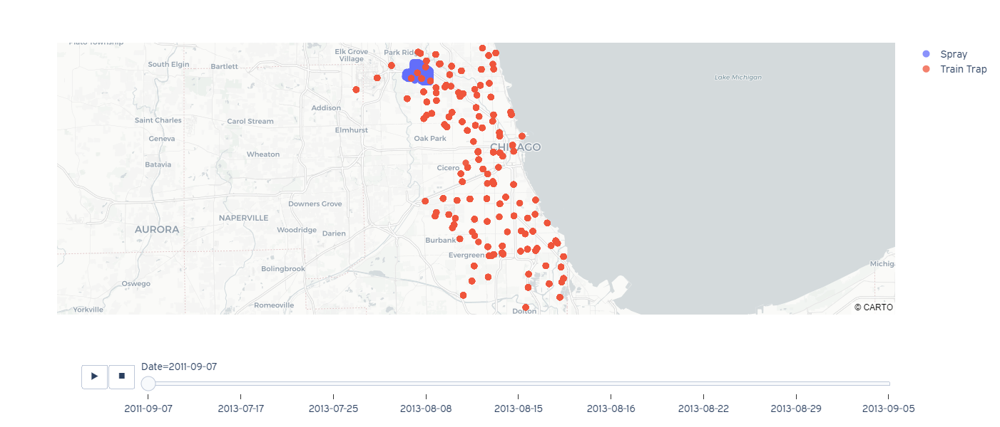

In [39]:
(express
 .scatter_mapbox(spray, 
                 lat="Latitude",
                 lon="Longitude", 
                 animation_frame="Date")
 .update_traces(name="Spray", 
                showlegend=True)
 .add_scattermapbox(name="Train Trap", 
                    lat=train["Latitude"], 
                    lon=train["Longitude"])
 .prettify()
 .update_layout(mapbox={"center": {"lat": 41.83, 
                                   "lon": -87.70}, 
                        "style": "carto-positron", 
                        "zoom": 9},
                width=800, 
                height=600)
 .update_traces(hovertemplate="<br>".join(preset))
 .update_traces(marker={"size": 10})
 .hide_widgets())

## EDA

### Spray x Train

In [40]:
# Set the `Date` column as the index.
spray.set_index(pd.DatetimeIndex(spray["Date"]), inplace=True)

# Drop the `Date` column.
spray.drop(columns="Date", inplace=True)

In [41]:
spray.head()

,Latitude,Longitude
Date,,
2011-09-07,41.981433,-87.787777
2011-09-07,41.980998,-87.787778
2011-09-07,41.980560,-87.787762
2011-09-07,41.980198,-87.787758
2011-09-07,41.979752,-87.787765


In [42]:
spray_dates = spray.index.unique()

In [43]:
spray_dates

DatetimeIndex(['2011-09-07', '2013-07-17', '2013-07-25', '2013-08-08',
               '2013-08-15', '2013-08-16', '2013-08-22', '2013-08-29',
               '2013-09-05'],
              dtype='datetime64[ns]', name='Date', freq=None)

In [44]:
train_sprayed = train.loc[train.index.intersection(spray_dates)]

In [45]:
train_sprayed.head()

,Species,Trap,Latitude,Longitude,NumMosquitos,WnvPresent
Date,,,,,,
2013-07-25,CULEX RESTUANS,T002,41.954690,-87.800991,21,0
2013-07-25,CULEX RESTUANS,T048,41.867108,-87.654224,42,0
2013-07-25,CULEX RESTUANS,T054,41.921965,-87.632085,3,1
2013-07-25,CULEX RESTUANS,T159,41.732984,-87.649642,20,0
2013-07-25,CULEX RESTUANS,T031,41.801498,-87.763416,5,0


In [46]:
train_sprayed = train_sprayed.merge(spray, how="left", on="Date", suffixes=["_Train", "_Spray"])

In [47]:
train_sprayed.head()

,Species,Trap,Latitude_Train,Longitude_Train,NumMosquitos,WnvPresent,Latitude_Spray,Longitude_Spray
Date,,,,,,,,
2013-07-25,CULEX RESTUANS,T002,41.95469,-87.800991,21,0,41.960520,-87.739783
2013-07-25,CULEX RESTUANS,T002,41.95469,-87.800991,21,0,41.960515,-87.739787
2013-07-25,CULEX RESTUANS,T002,41.95469,-87.800991,21,0,41.960508,-87.739787
2013-07-25,CULEX RESTUANS,T002,41.95469,-87.800991,21,0,41.960498,-87.739792
2013-07-25,CULEX RESTUANS,T002,41.95469,-87.800991,21,0,41.960527,-87.739800


In [48]:
train_sprayed.shape

(651162, 8)

In [49]:
train_sprayed["Distance"] = ((train_sprayed["Latitude_Spray"] - train_sprayed["Latitude_Train"]) ** 2 + 
                             (train_sprayed["Longitude_Spray"] - train_sprayed["Longitude_Train"]) ** 2) ** 0.5

In [50]:
train_sprayed["Latitude_Train"].min()

41.659112

In [51]:
train_sprayed[train_sprayed["Latitude_Train"] == 41.659112].loc["2013-07-25"].sort_values("Distance")

,Species,Trap,Latitude_Train,Longitude_Train,NumMosquitos,WnvPresent,Latitude_Spray,Longitude_Spray,Distance
Date,,,,,,,,,
2013-07-25,CULEX PIPIENS/RESTUANS,T221,41.659112,-87.538693,15,0,41.940342,-87.713297,0.331024
2013-07-25,CULEX RESTUANS,T221,41.659112,-87.538693,17,0,41.940342,-87.713297,0.331024
2013-07-25,CULEX RESTUANS,T221,41.659112,-87.538693,34,0,41.940342,-87.713297,0.331024
2013-07-25,CULEX RESTUANS,T221,41.659112,-87.538693,17,0,41.940258,-87.713698,0.331165
2013-07-25,CULEX RESTUANS,T221,41.659112,-87.538693,34,0,41.940258,-87.713698,0.331165
...,...,...,...,...,...,...,...,...,...
2013-07-25,CULEX RESTUANS,T221,41.659112,-87.538693,17,0,41.967653,-87.736600,0.366558
2013-07-25,CULEX RESTUANS,T221,41.659112,-87.538693,34,0,41.967653,-87.736600,0.366558
2013-07-25,CULEX RESTUANS,T221,41.659112,-87.538693,17,0,41.967420,-87.737760,0.366990


In [52]:
distance = train_sprayed.groupby(["Date", "Trap"])["Distance"].min().reset_index()

In [53]:
distance.head()

,Date,Trap,Distance
0,2013-07-25,T002,0.061396
1,2013-07-25,T008,0.057317
2,2013-07-25,T009,0.127174
3,2013-07-25,T012,0.025766
4,2013-07-25,T018,0.063778


In [54]:
distance.shape

(225, 3)

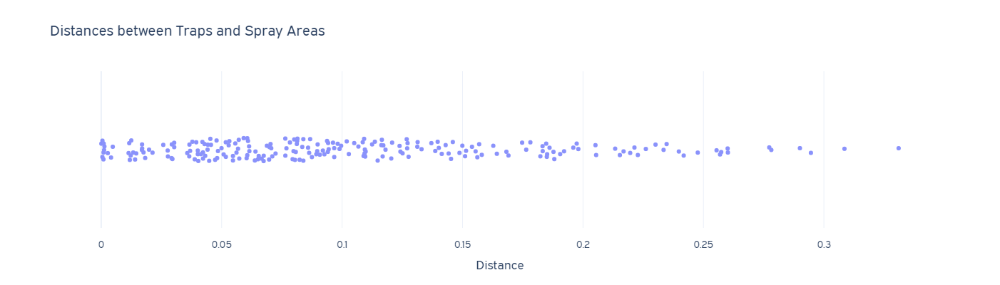

In [55]:
(express
 .strip(distance,
        x="Distance", 
        title="Distances between Traps and Spray Areas")
 .prettify()
 .hide_widgets())

I think the cutoff distance should be 0.002. Any trap with distance less than 0.002 from the nearest spray area is considered sprayed and thus, is expected to find less mosquitos.